# Importing Libraries


In [13]:
#Importing necessary dependancies
import os
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from glob import glob
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import Input
from tensorflow.keras.models import Model, load_model, save_model ,Sequential
from tensorflow.keras.layers import Input, Activation, BatchNormalization, Dropout, Lambda, Conv2D,MaxPooling2D, concatenate, Dense, Flatten, UpSampling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import Recall, Precision
from tensorflow.keras import backend as K
import tensorflow as tf
import tensorflow.keras.layers as L
from tensorflow.keras.models import Model
from tensorflow.keras.applications import resnet50

In [14]:
#Loading the black and white mask images
mask_files = glob('../input/lgg-mri-segmentation/kaggle_3m/*/*_mask*')
#Loading the brain images
image_files = [file.replace('_mask', '') for file in mask_files]

In [15]:
#Defining the function for labeling the masks
def mask_labelizer(mask_image):
    mask_image=cv2.imread(mask_image)
    label=np.max(mask_image)
    if(label>0):
        label=1
    else:
        label=0
    return label
#Assembling the MRI scans with their corresponding masks into a dataframe
MRI_DATA = pd.DataFrame(
    {              "images": image_files,
                   "masks": mask_files,
                   "label":[
                       mask_labelizer(mask) for mask in mask_files #Using List Apprehension
                   ]}
)
#Displaying the dataframe
MRI_DATA.head()

,images,masks,label
0,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0
1,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0
2,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1
3,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1
4,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,../input/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1


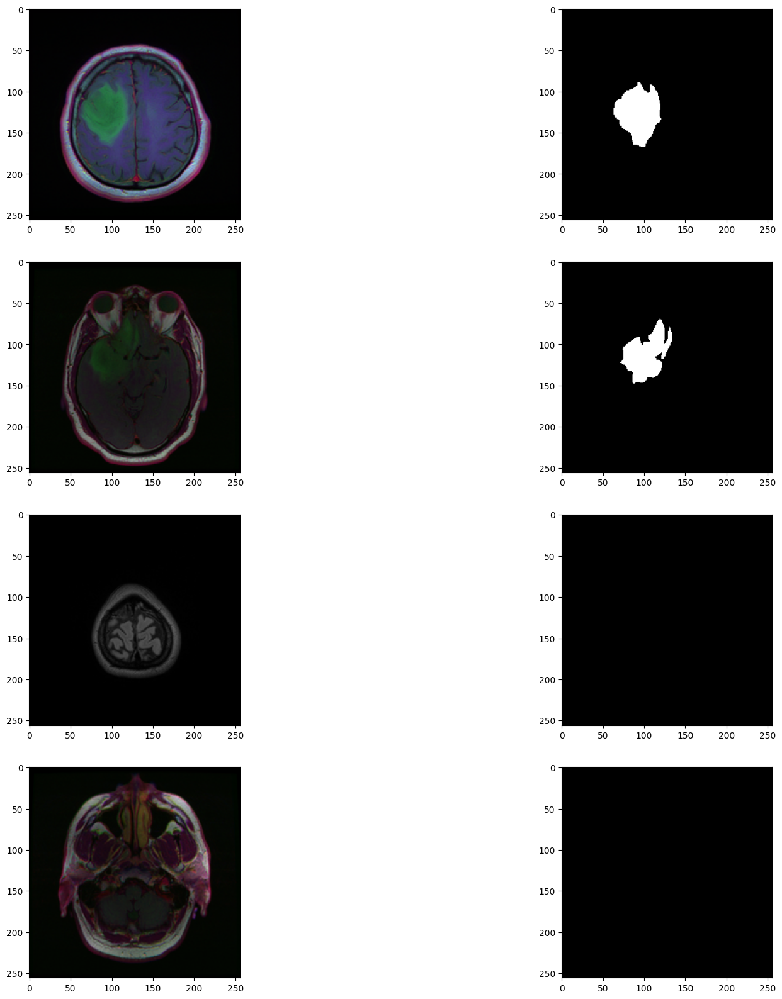

In [16]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(figsize=[20,20])
images,masks=[],[]

random_idc=np.random.randint(low=1,high=1000,size=100)

for i in random_idc:
    images.append(np.array(cv2.imread(MRI_DATA['images'].iloc[i])))
    masks.append(np.array(cv2.imread(MRI_DATA['masks'].iloc[i])))

plt.subplot(4,2,1)
plt.imshow(images[0])
plt.subplot(4,2,2)
plt.imshow(masks[0])
plt.subplot(4,2,3)
plt.imshow(images[1])
plt.subplot(4,2,4)
plt.imshow(masks[1])
plt.subplot(4,2,5)
plt.imshow(images[2])
plt.subplot(4,2,6)
plt.imshow(masks[3])
plt.subplot(4,2,7)
plt.imshow(images[3])
plt.subplot(4,2,8)
plt.imshow(masks[3])

In [17]:
from sklearn.model_selection import train_test_split
MRI_train,MRI_test=train_test_split(MRI_DATA,test_size=0.1,random_state=0)
MRI_test,MRI_val=train_test_split(MRI_test,test_size=0.5,random_state=0)
print('Shape of training data : {}\nShape of test data: {}\nShape of Validation data: {} '.format(len(MRI_train),len(MRI_test),len(MRI_val)))

Shape of training data : 3536
Shape of test data: 196
Shape of Validation data: 197 


In [18]:
'''Function for preprocessing images'''
#---------------------------------------------------------------------------------------------------------------------------------------------------------#
def preprocess_data(img,mask):
    img = img / 255.
    mask = mask / 255.
    #Converting Masks into black and white images
    mask[mask>0.5]=1
    mask[mask<=0.5]=0
    return (img, mask)
#---------------------------------------------------------------------------------------------------------------------------------------------------------#
'''Function for data augmentation'''
def image_augmentor(
       data_frame, batch_size,
        aug_dict,
        image_color_mode="rgb",
        mask_color_mode="grayscale",
        image_save_prefix="image",
        mask_save_prefix="mask",
        save_to_dir=None,
        target_size=(256,256),
        seed=1):

    image_datagen = ImageDataGenerator(**aug_dict)#Data Generator for Images
    mask_datagen = ImageDataGenerator(**aug_dict) #Data Generator for Masks
    
   #----------------------------------------image augmentation for MRI scans-------------------------------------------------------------------------------
    image_generator = image_datagen.flow_from_dataframe(
        data_frame,
        x_col = "images",
        class_mode = None,
        color_mode = image_color_mode,
        target_size = target_size,
        batch_size = batch_size,
        save_to_dir = save_to_dir,
        save_prefix  = image_save_prefix,
        seed = seed)
   #-----------------------------------------------------image augmentation for masks-----------------------------------------------------------------------

    mask_generator = mask_datagen.flow_from_dataframe(
        data_frame,
        x_col = "masks",
        class_mode = None,
        color_mode = mask_color_mode,
        target_size = target_size,
        batch_size = batch_size,
        save_to_dir = save_to_dir,
        save_prefix  = mask_save_prefix,
        seed = seed)
  #--------------------------------------------------------------------------------------------------------------------------------------------------------
    train_augmentor = zip(image_generator, mask_generator)
    
    for (image, mask) in train_augmentor:
        image, mask = preprocess_data(image, mask)
        yield (image,mask)

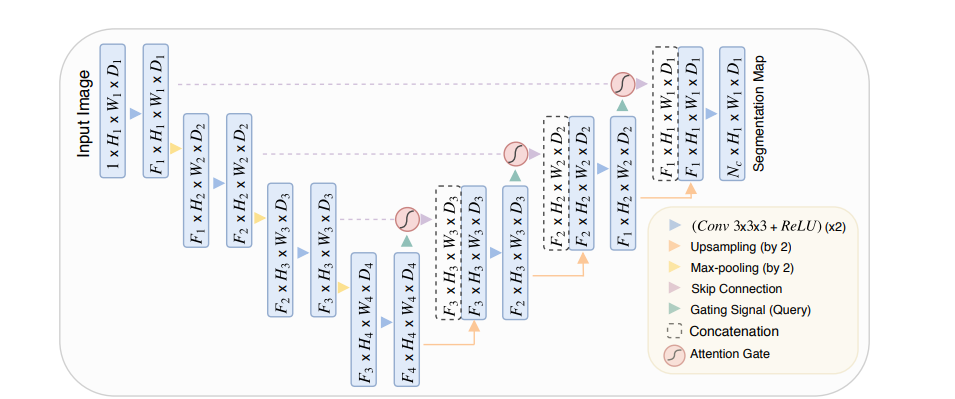![Res-U-Net-architecture-a-basic-block-of-the-

# Model Architecture- Code

In [19]:
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras.models import Model
from tensorflow.keras.applications import ResNet50


# #lambda function for repeating the result from AG
def repeat_elem(tensor, rep):
   
     return tf.keras.layers.Lambda(lambda x, repnum: K.repeat_elements(x, repnum, axis=3),arguments={'repnum': rep})(tensor)



# Attention Gate


def attention_gate(g, s, num_filters):
    
    '''
    Attention Gate
    Inputs: 
        1.g: feature map from previous decoding layer
        2.s: corresponding skip connection from encoder
        
    Output:
        Attention map of the skip connection.
    '''
    Wg=L.Conv2D(num_filters,1,padding="same")(g)
    Wg=L.BatchNormalization()(Wg)
    Ws=L.Conv2D(num_filters,1,padding="same")(s)
    Ws=L.BatchNormalization()(Ws)
    
    out = L.Activation("relu")(Wg + Ws)
    out = L.Conv2D(num_filters, 1, padding="same")(out)
    out = L.Activation("sigmoid")(out)

    return out * s

def encoder_block(x, num_filters):
    x = conv_block(x, num_filters)
    p = L.MaxPool2D((2, 2))(x)
    return x, p

# Convolution Block: Used in both encoder and decoder.

def conv_block(input, num_filters):
    
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x
  
    
# Decoder Block

def decoder_block(x, s, num_filters,attention=True):
    '''
    Input:
        1. x : Previous decoder layer output
        2. s : Corresponding layer from encoder (skip-connection)
        3. attention: True 
        
    '''

    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(x)
    s = attention_gate(x, s, num_filters)
    x = Concatenate()([x, s])
    x = conv_block(x, num_filters)
    return x

        

def attention_unet(input_shape):
    """ Inputs """
    inputs = L.Input(input_shape)

    """ Encoder """
    #Inp: 256,256,3 Out:(256,256,64),(128,128,64)
    s1, p1 = encoder_block(inputs, 64)
    #Inp: 128,128,64 Out:(128,128,128),(64,64,128)
    s2, p2 = encoder_block(p1, 128)
    #Inp: 64,64,128 Out:(64,64,256),(32,32,256)
    s3, p3 = encoder_block(p2, 256)
    #Inp: 32,32,256 Out:(32,32,512)
    b1 = conv_block(p3, 512)

    """ Decoder """
    d1 = decoder_block(b1, s3, 256)
    d2 = decoder_block(d1, s2, 128)
    d3 = decoder_block(d2, s1, 64)

    """ Outputs """
    outputs = L.Conv2D(1, 1, padding="same", activation="sigmoid")(d3)

    """ Model """
    model = Model(inputs, outputs, name="Attention-UNET")
    return model
   

input_shape = (256, 256, 3)
model = attention_unet(input_shape)
model.summary()

Model: "Attention-UNET"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d_24 (Conv2D)          (None, 256, 256, 64)         1792      ['input_2[0][0]']             
                                                                                                  
 batch_normalization_20 (Ba  (None, 256, 256, 64)         256       ['conv2d_24[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_20 (Activation)  (None, 256, 256, 64)         0         ['batch_normaliza

# Loss Function and Metrics

In [20]:
smooth=1.
#-----------------------------------------------------------------------------------------------------------------------------------------------------------#
'''Function for returning dice coefficient'''
def dice_coef(y_true, y_pred):
    y_true = K.flatten(y_true)
    y_pred = K.flatten(y_pred)
    intersection = K.sum(y_true * y_pred)
    union = K.sum(y_true) + K.sum(y_pred)
    return (2.0 * intersection + smooth) / (union + smooth)
#-----------------------------------------------------------------------------------------------------------------------------------------------------------#

'''Dice Coefficient Loss'''
def dice_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

#----------------------------------------------------------------------------------------------------------------------------------------------------------#
'''Function for combining binary cross entropy with dice coeffcients for loss function'''
def bce_dice_loss(y_true, y_pred):
    bce = tf.keras.losses.BinaryCrossentropy()
    return dice_coef_loss(y_true, y_pred) + bce(y_true, y_pred)

#----------------------------------------------------------------------------------------------------------------------------------------------------------#

'''Function for Jacards coefficient'''
def iou(y_true, y_pred):
    y_true=K.flatten(y_true)
    y_pred=K.flatten(y_pred)
    intersection = K.sum(y_true * y_pred)
    sum_jac = K.sum(y_true + y_pred)
    jac = (intersection + smooth) / (sum_jac - intersection + smooth)
    return jac

# Hàm Mean Squared Error
def mean_squared_error(y_true, y_pred):
    return K.mean(K.square(y_pred - y_true), axis=-1)

In [21]:
EPOCHS = 100
BATCH_SIZE = 16
learning_rate = 0.001
train_generator_args = dict(rotation_range=0.1,
                            width_shift_range=0.05,
                            height_shift_range=0.05,
                            shear_range=0.05,
                            zoom_range=0.05,
                            horizontal_flip=True,
                            vertical_flip=True,
                            fill_mode='nearest')

train_generator = image_augmentor(MRI_train, BATCH_SIZE,
                                train_generator_args,
                                target_size=(256,256))
    
validation_generator = image_augmentor(MRI_val, BATCH_SIZE,
                                dict(),
                                target_size=(256,256))

In [22]:
opt = Adam(learning_rate=learning_rate, beta_1=0.9, beta_2=0.9, epsilon=1e-07, amsgrad=False)

callbacks = [ModelCheckpoint('MRI_Attention_UNet_ResNet.hdf5', verbose=1, save_best_only=True),
            ReduceLROnPlateau(monitor='val_loss', factor=0.1, verbose=1, min_lr=1e-11)]
            
model.compile(optimizer=opt, loss=dice_loss, metrics=[iou, dice_coef,Precision(),Recall()])

In [23]:
history = model.fit(train_generator,
                    steps_per_epoch=len(MRI_train) // 16, 
                    epochs=EPOCHS, 
                    callbacks=callbacks,
                    validation_data = validation_generator,
                    validation_steps=len(MRI_val) // 16)

Found 3536 validated image filenames.
Found 3536 validated image filenames.
Epoch 1/100
221/221 [==============================] - ETA: 0s - loss: 0.6772 - iou: 0.2124 - dice_coef: 0.3228 - precision_1: 0.2090 - recall_1: 0.6487Found 197 validated image filenames.
Found 197 validated image filenames.

Epoch 1: val_loss improved from inf to 0.94531, saving model to MRI_Attention_UNet_ResNet.hdf5
221/221 [==============================] - 132s 528ms/step - loss: 0.6772 - iou: 0.2124 - dice_coef: 0.3228 - precision_1: 0.2090 - recall_1: 0.6487 - val_loss: 0.9453 - val_iou: 0.0283 - val_dice_coef: 0.0547 - val_precision_1: 0.0291 - val_recall_1: 0.9982 - lr: 0.0010
Epoch 2/100
221/221 [==============================] - ETA: 0s - loss: 0.4371 - iou: 0.4142 - dice_coef: 0.5629 - precision_1: 0.5763 - recall_1: 0.5785
Epoch 2: val_loss improved from 0.94531 to 0.89249, saving model to MRI_Attention_UNet_ResNet.hdf5
221/221 [==============================] - 118s 533ms/step - loss: 0.4371 - io

###### 

In [24]:
model.save('Segmentation_MRI_BRAIN_Attention_Encoded_Model_FINAL_2.h5')

In [25]:
test_gen = image_augmentor(MRI_test, BATCH_SIZE,
                                dict(),
                                target_size=(256,256))
results = model.evaluate(test_gen, steps=len(MRI_test) / BATCH_SIZE)
print("Test IOU: ",results[1])
print("Test Dice Coefficent: ",results[2])
print("Test Mean Squared Error: ",results[3])

Found 196 validated image filenames.
Found 196 validated image filenames.
12/12 [==============================] - 4s 315ms/step - loss: 0.1155 - iou: 0.8084 - dice_coef: 0.8895 - precision_1: 0.9196 - recall_1: 0.8819
Test IOU:  0.8084484934806824
Test Dice Coefficent:  0.8894612193107605
Test Mean Squared Error:  0.9195929765701294


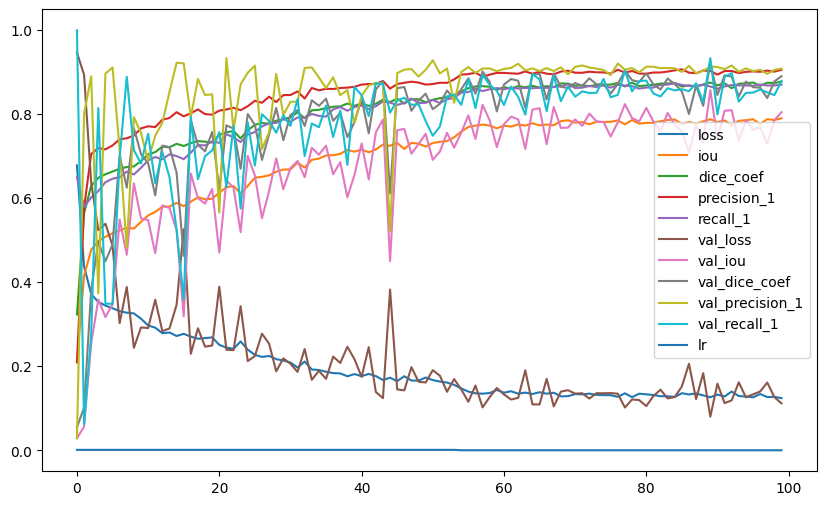

In [26]:
plt.figure(figsize=[10,6])
for key in history.history.keys():
    plt.plot(history.history[key], label=key)
    
plt.legend()
plt.show()

**Predictions**

1/1 [==============================] - 1s 1s/step


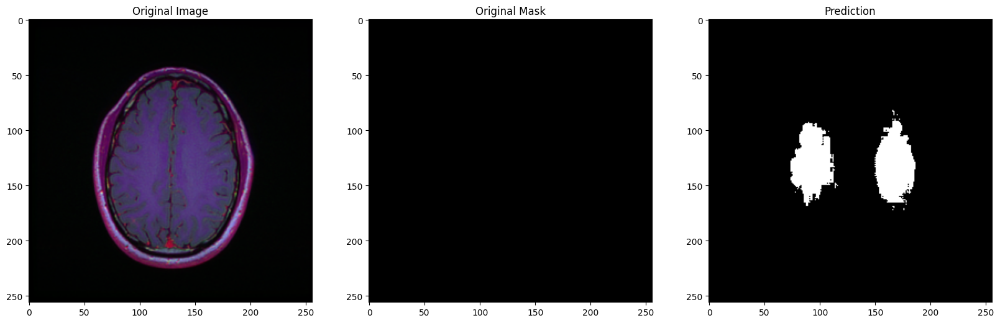

1/1 [==============================] - 0s 26ms/step


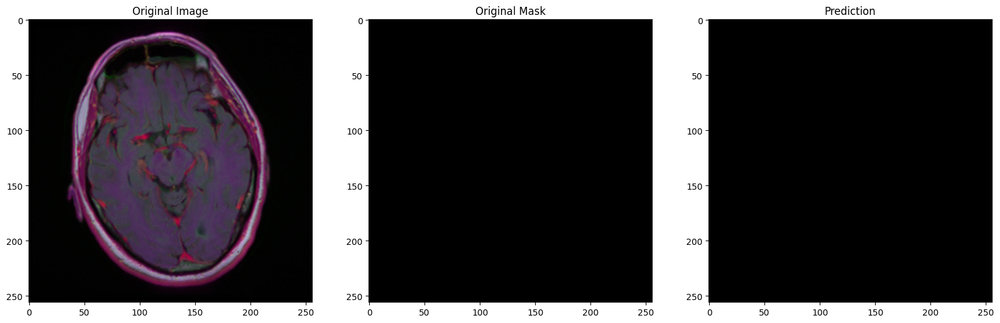

1/1 [==============================] - 0s 24ms/step


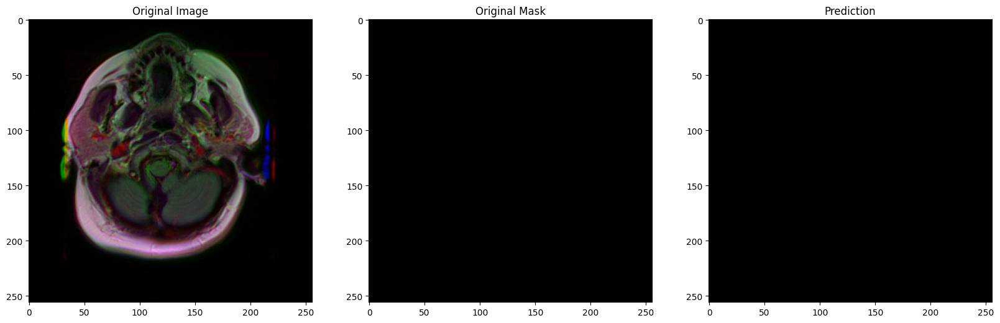

1/1 [==============================] - 0s 24ms/step


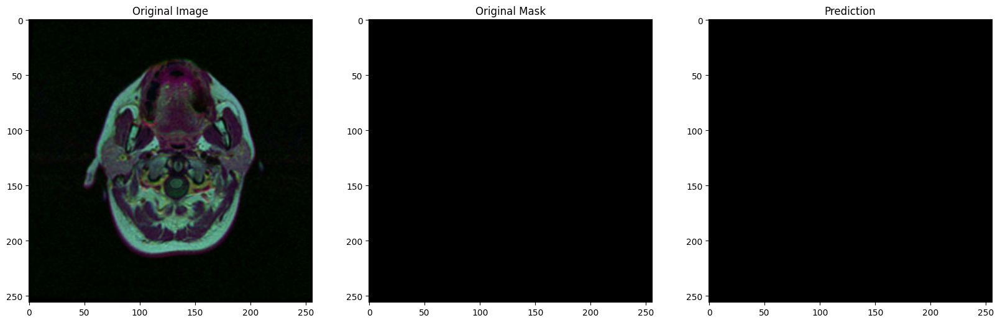

1/1 [==============================] - 0s 27ms/step


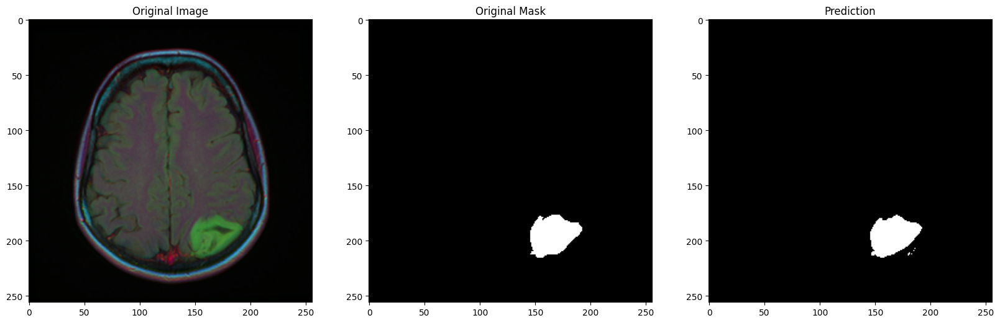

1/1 [==============================] - 0s 25ms/step


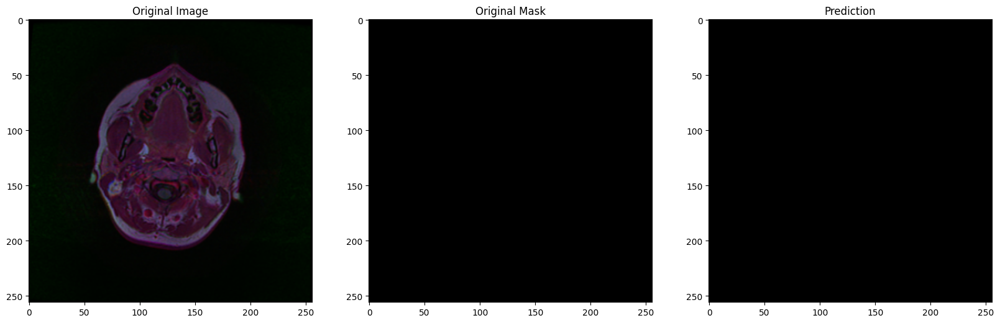

1/1 [==============================] - 0s 25ms/step


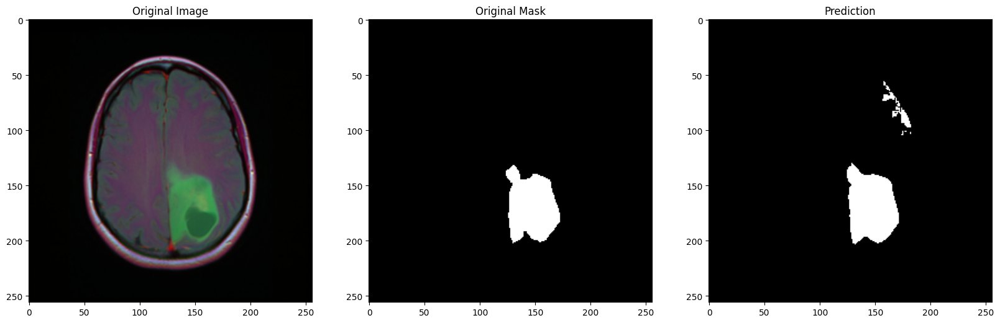

1/1 [==============================] - 0s 26ms/step


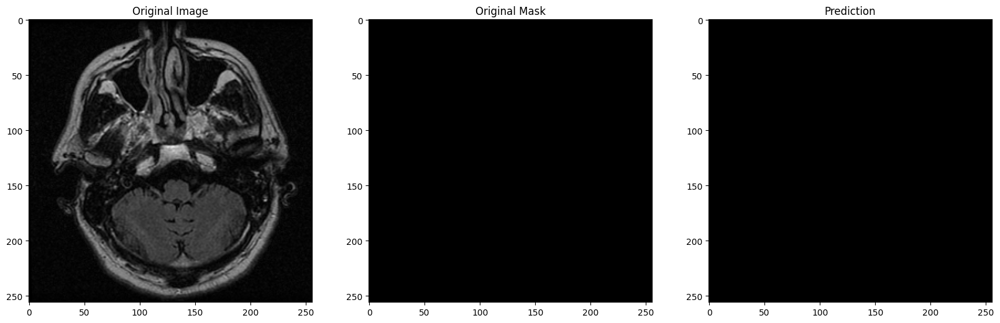

1/1 [==============================] - 0s 25ms/step


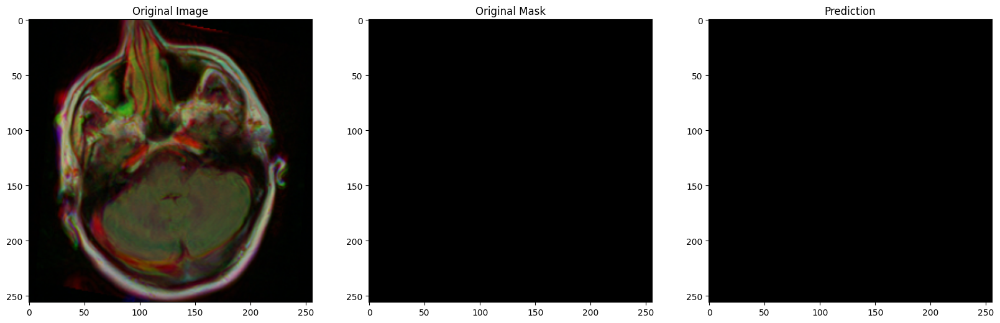

1/1 [==============================] - 0s 25ms/step


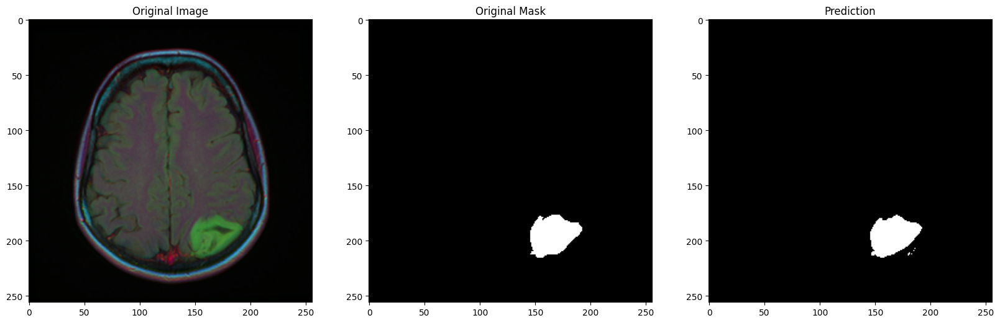

1/1 [==============================] - 0s 25ms/step


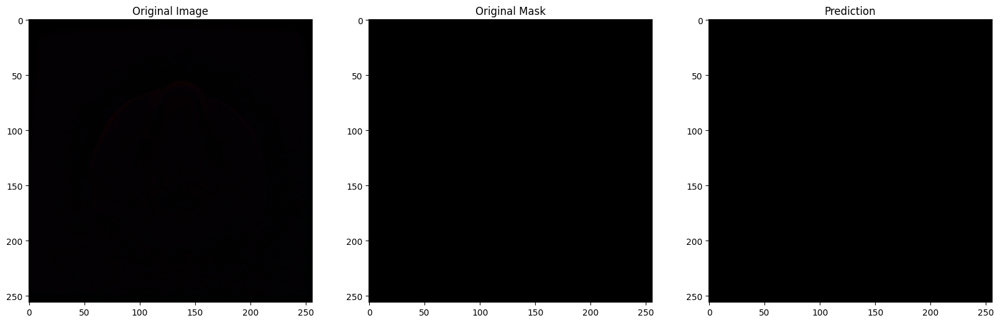

1/1 [==============================] - 0s 26ms/step


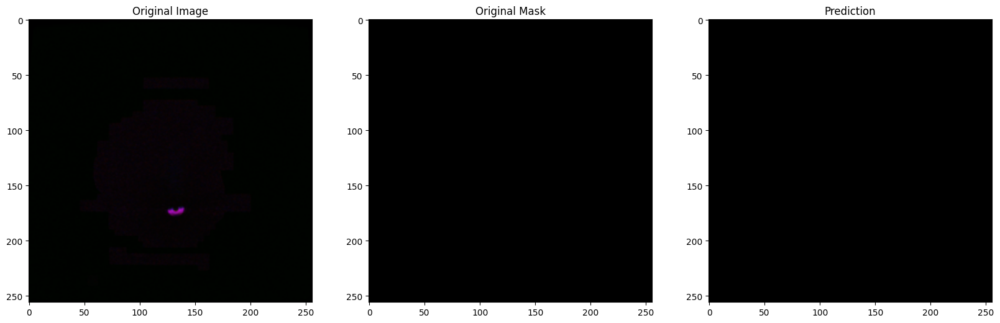

1/1 [==============================] - 0s 23ms/step


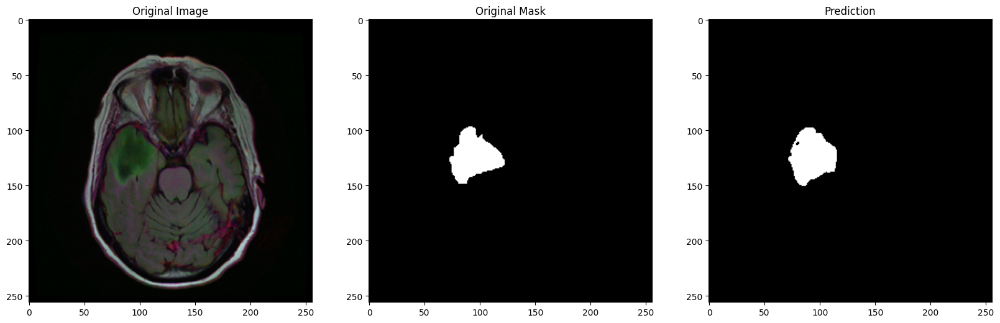

1/1 [==============================] - 0s 25ms/step


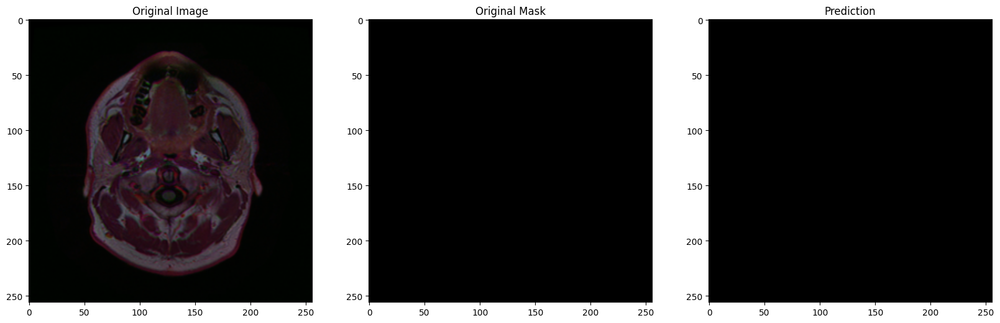

1/1 [==============================] - 0s 27ms/step


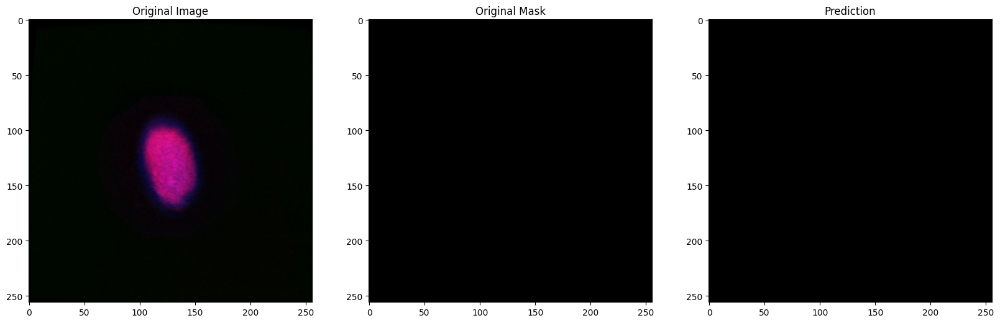

1/1 [==============================] - 0s 24ms/step


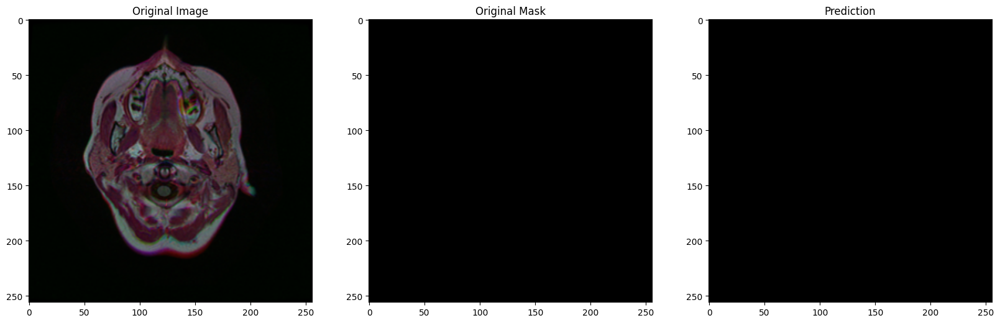

1/1 [==============================] - 0s 24ms/step


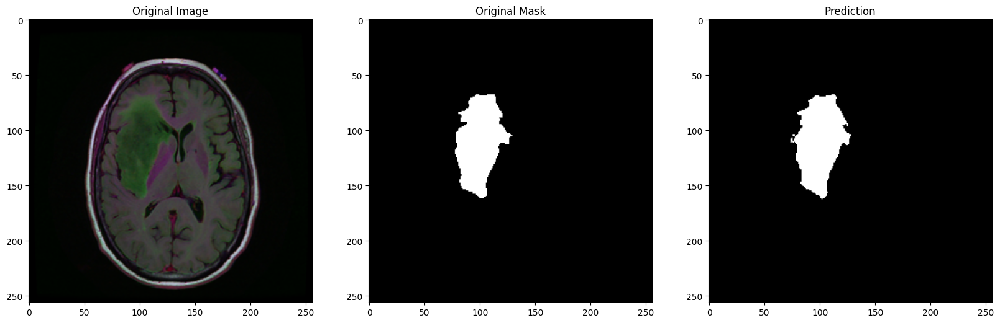

1/1 [==============================] - 0s 26ms/step


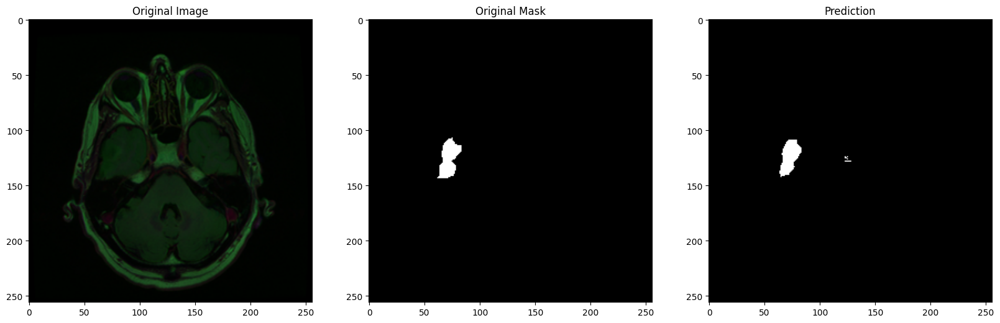

1/1 [==============================] - 0s 24ms/step


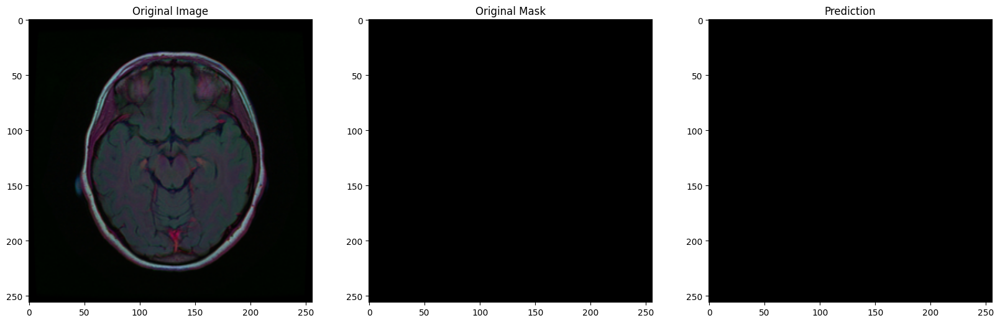

1/1 [==============================] - 0s 25ms/step


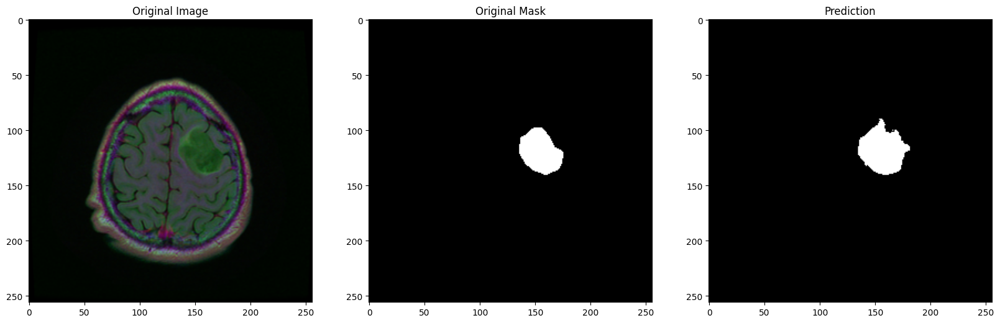

1/1 [==============================] - 0s 25ms/step


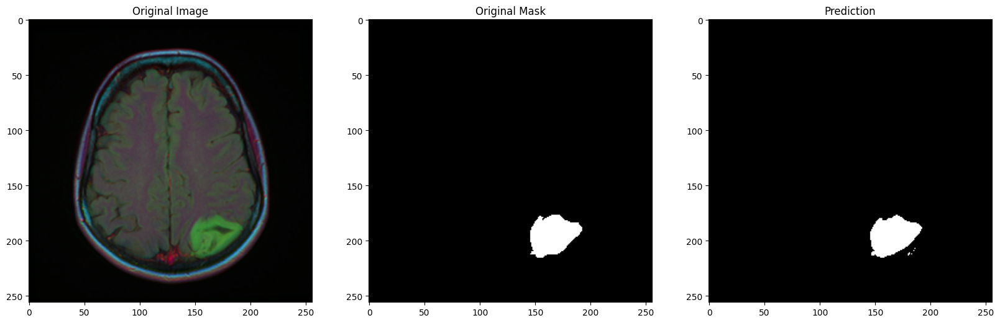

1/1 [==============================] - 0s 25ms/step


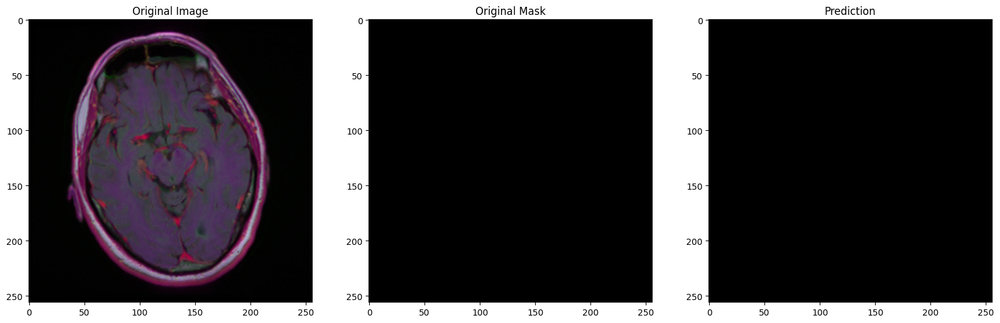

1/1 [==============================] - 0s 24ms/step


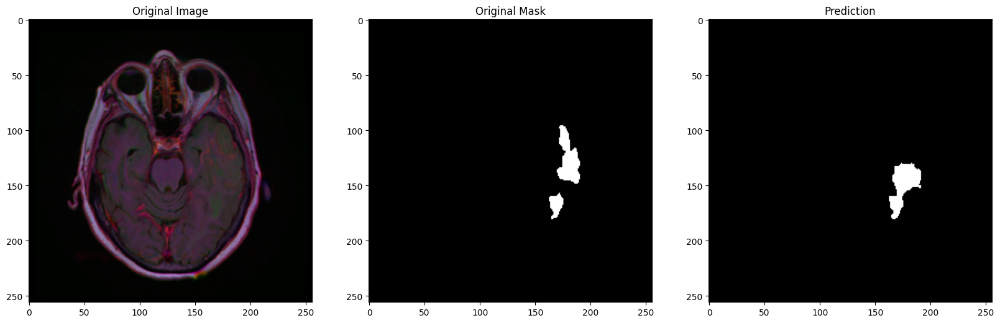

1/1 [==============================] - 0s 25ms/step


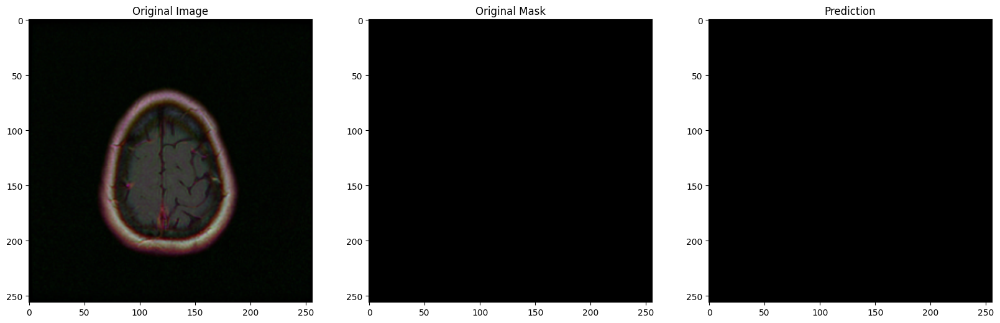

1/1 [==============================] - 0s 24ms/step


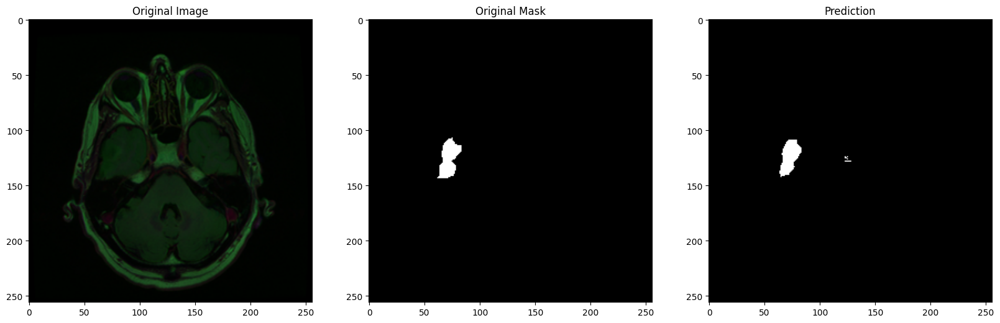

1/1 [==============================] - 0s 26ms/step


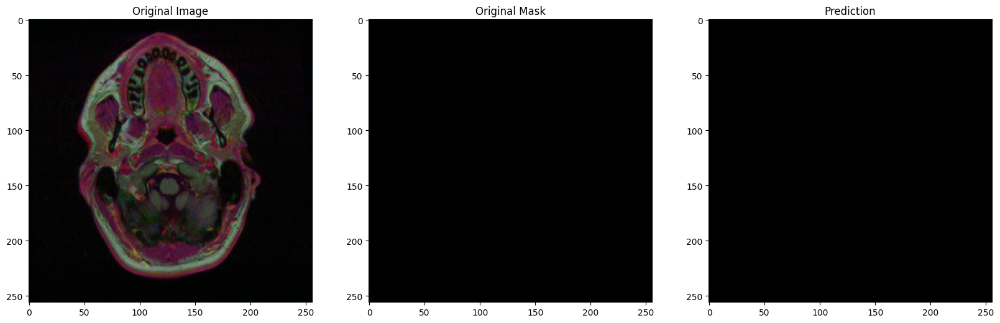

1/1 [==============================] - 0s 27ms/step


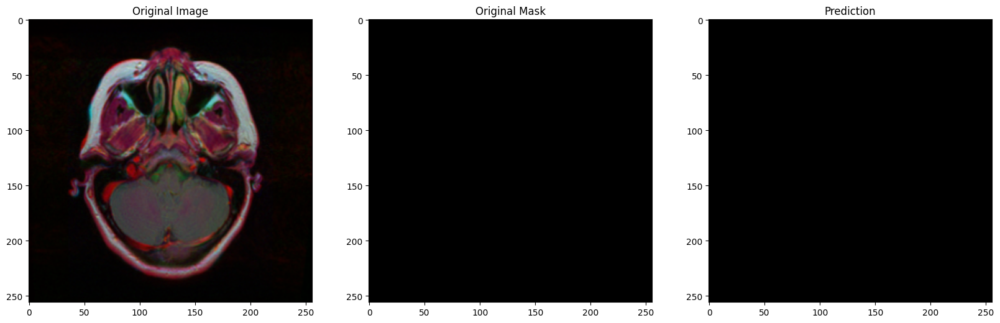

1/1 [==============================] - 0s 25ms/step


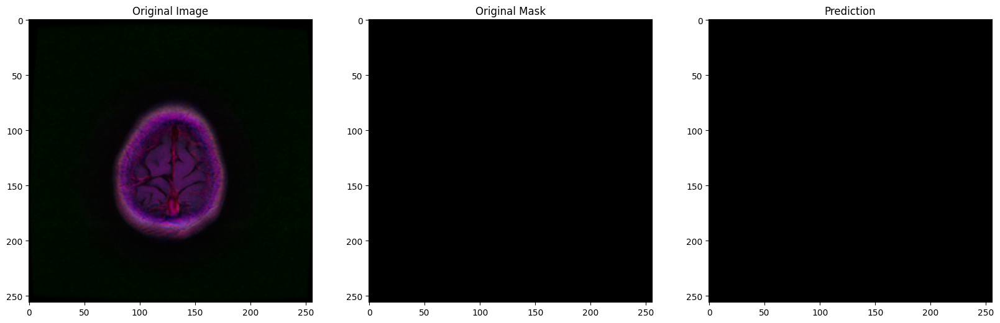

1/1 [==============================] - 0s 25ms/step


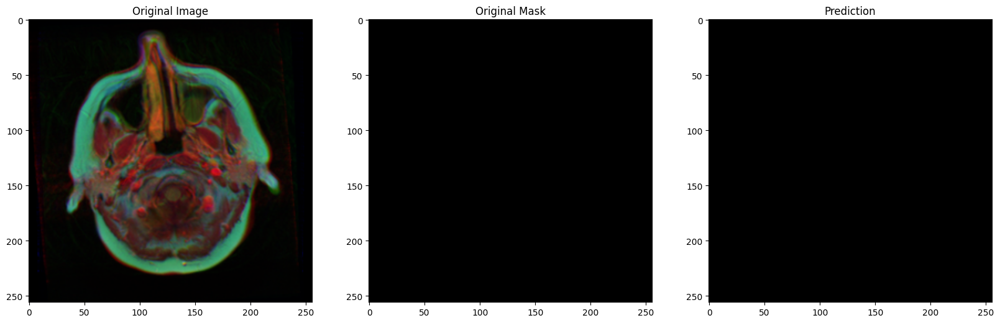

1/1 [==============================] - 0s 25ms/step


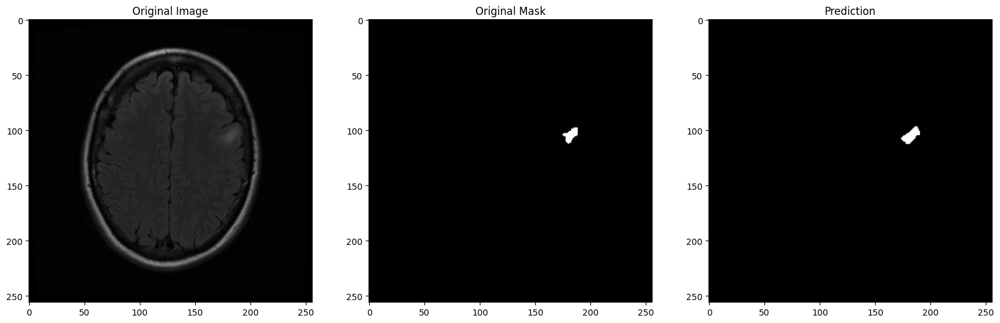

1/1 [==============================] - 0s 31ms/step


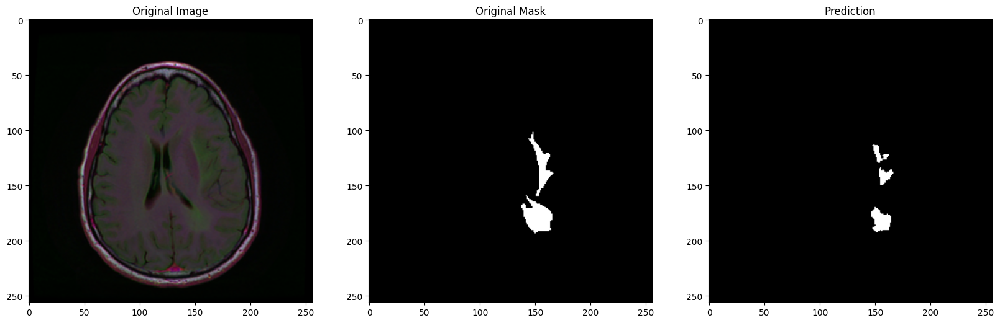

1/1 [==============================] - 0s 26ms/step


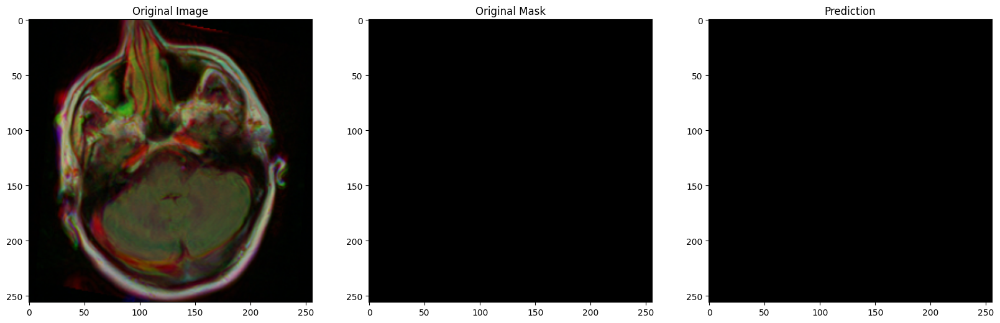

1/1 [==============================] - 0s 26ms/step


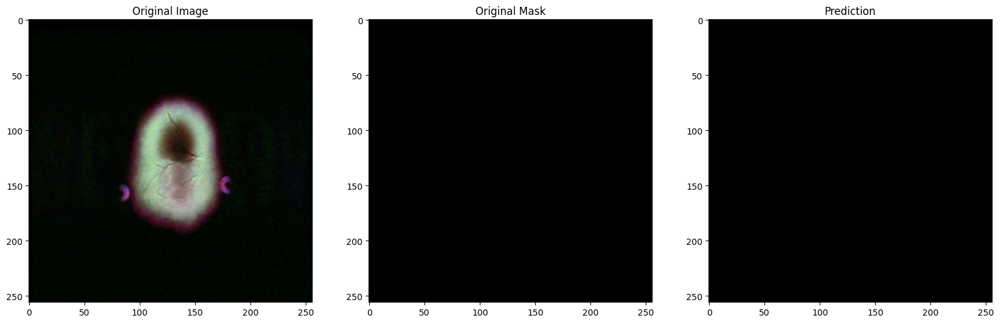

1/1 [==============================] - 0s 25ms/step


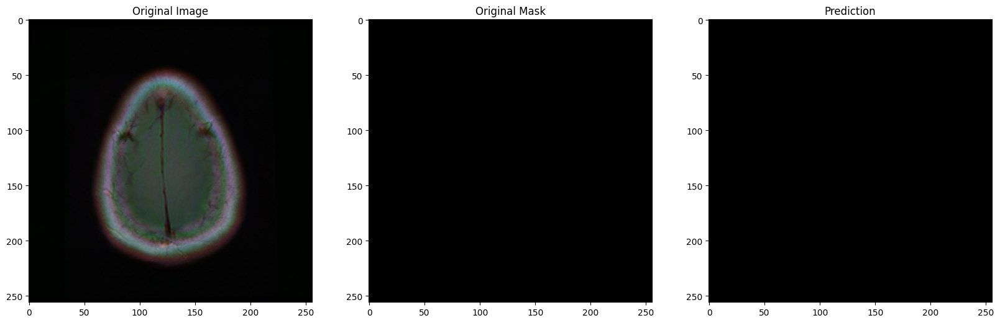

1/1 [==============================] - 0s 25ms/step


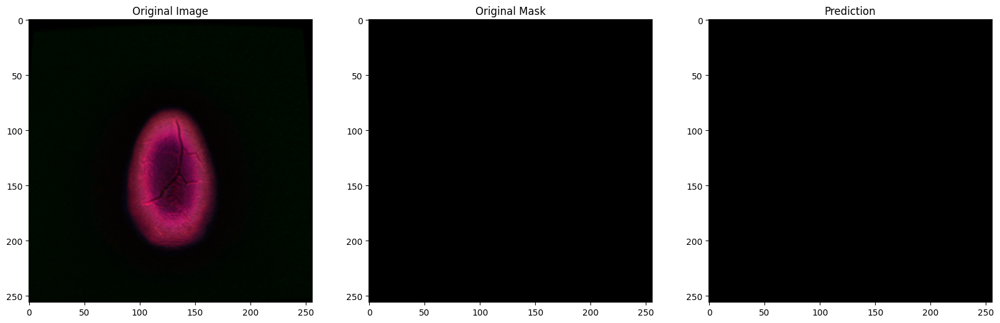

1/1 [==============================] - 0s 26ms/step


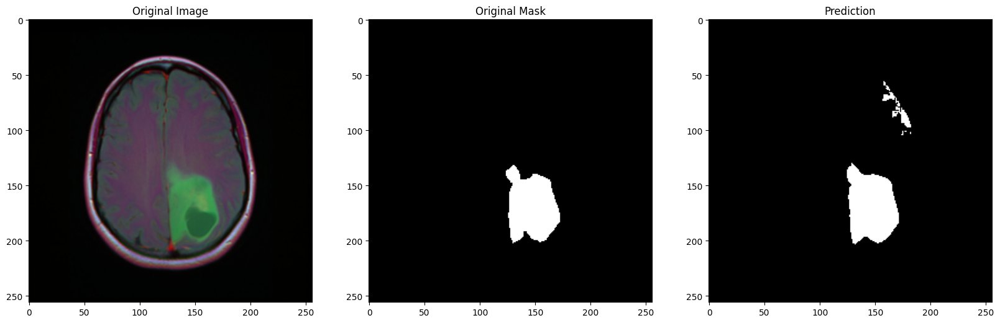

1/1 [==============================] - 0s 24ms/step


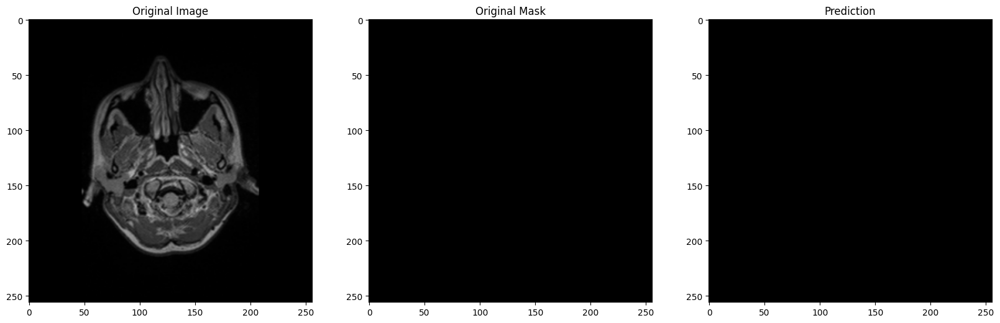

1/1 [==============================] - 0s 24ms/step


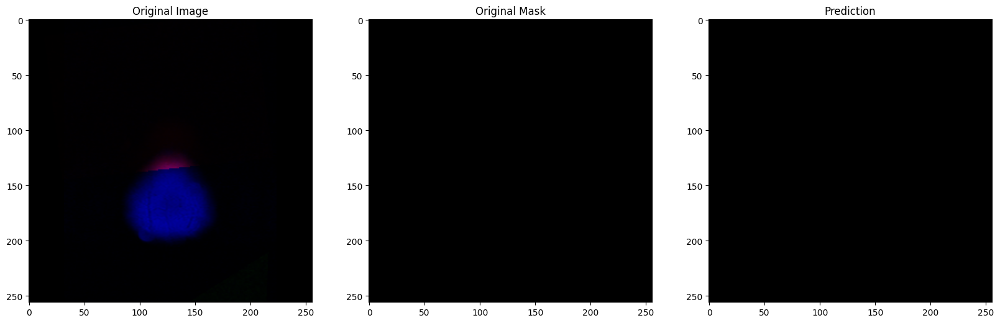

1/1 [==============================] - 0s 23ms/step


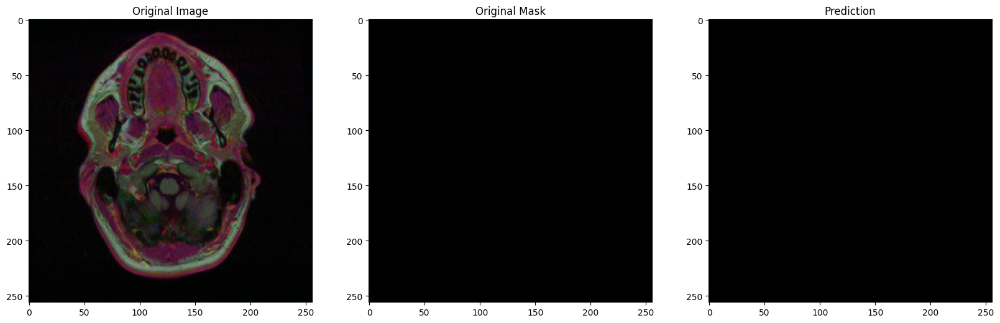

1/1 [==============================] - 0s 25ms/step


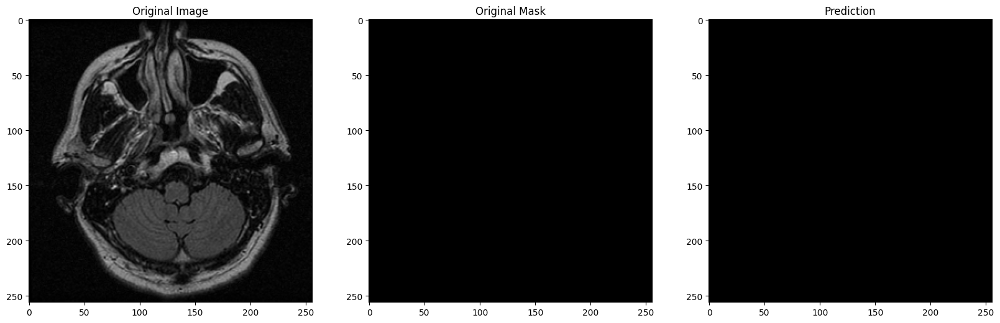

1/1 [==============================] - 0s 26ms/step


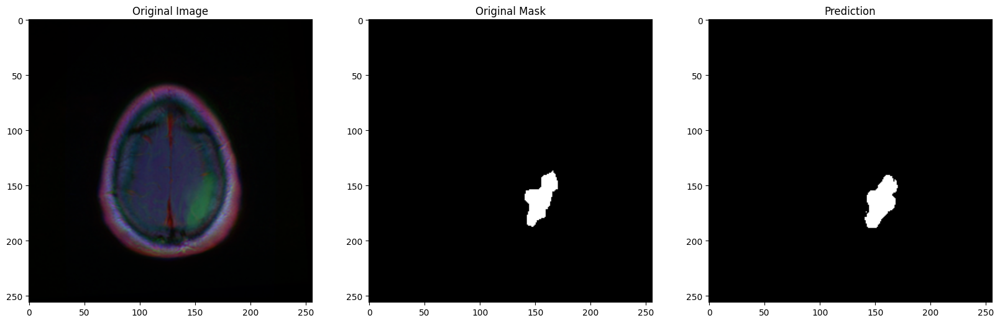

1/1 [==============================] - 0s 24ms/step


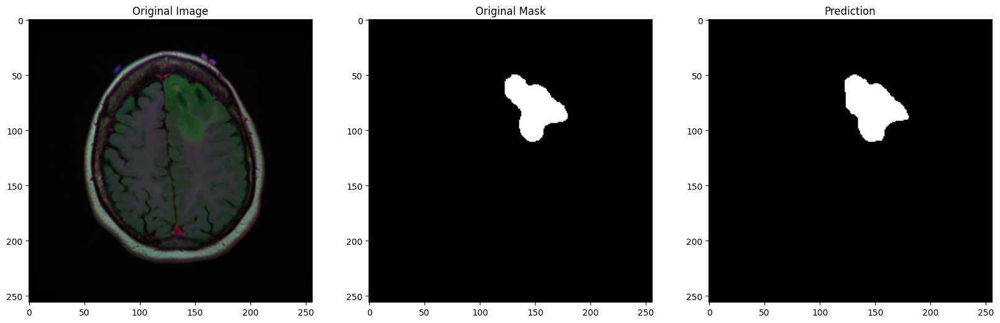

1/1 [==============================] - 0s 25ms/step


In [ ]:
for i in range(50):
    #------------------------------------------------------------------------------------------------------------------------------------------------------#
    index=np.random.randint(1,len(MRI_test.index))
    img = cv2.imread(MRI_test['images'].iloc[index])
    img = cv2.resize(img ,(256,256))
    img = img / 255
    img = img[np.newaxis, :, :, :]#Increasing the dimensions for predictions
    pred=model.predict(img)
    #------------------------------------------------------------------------------------------------------------------------------------------------------#
    plt.figure(figsize=(20,12))
    plt.subplot(1,3,1)
    plt.imshow(np.squeeze(img))
    plt.title('Original Image')
    plt.subplot(1,3,2)
    plt.imshow(np.squeeze(cv2.imread(MRI_test['masks'].iloc[index]))) #Reducing dimensions
    plt.title('Original Mask')
    plt.subplot(1,3,3)
    plt.imshow(np.squeeze(pred) > .5,cmap='gray')
    plt.title('Prediction')
    plt.show()

1/1 [==============================] - 0s 27ms/step


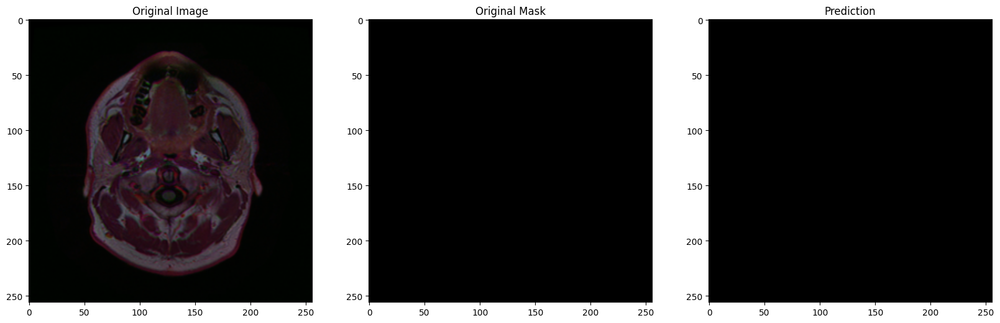

1/1 [==============================] - 0s 24ms/step


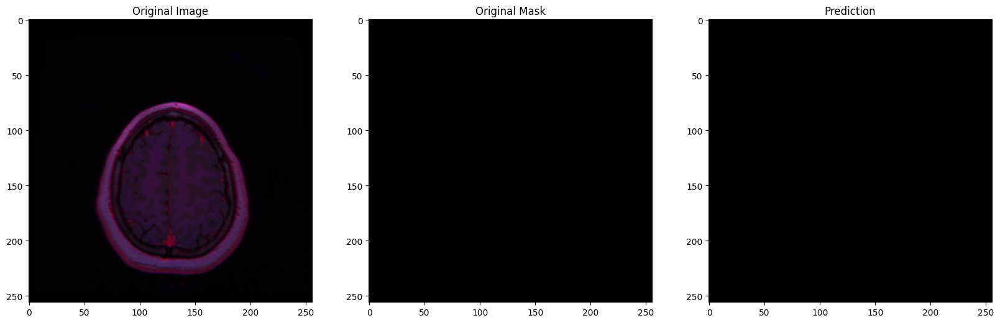

1/1 [==============================] - 0s 25ms/step


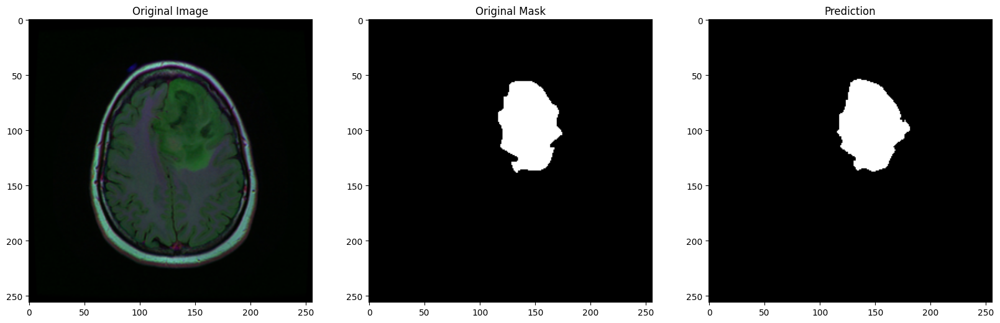

1/1 [==============================] - 0s 22ms/step


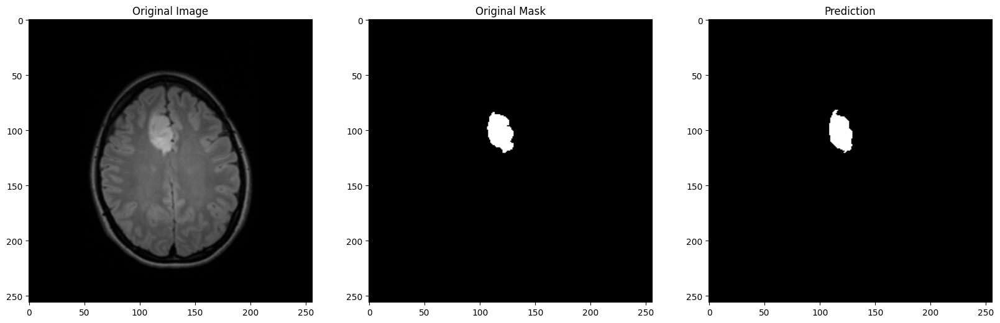

1/1 [==============================] - 0s 26ms/step


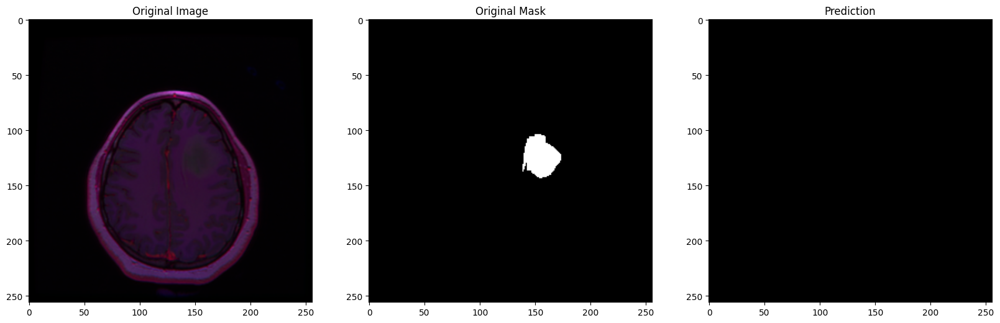

1/1 [==============================] - 0s 25ms/step


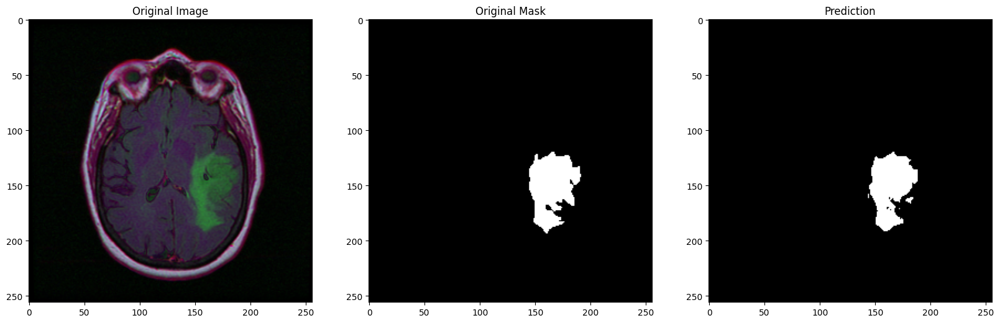

1/1 [==============================] - 0s 23ms/step


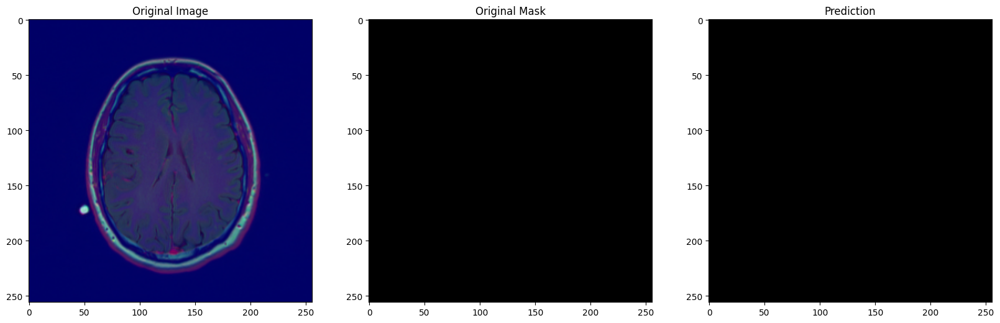

1/1 [==============================] - 0s 26ms/step


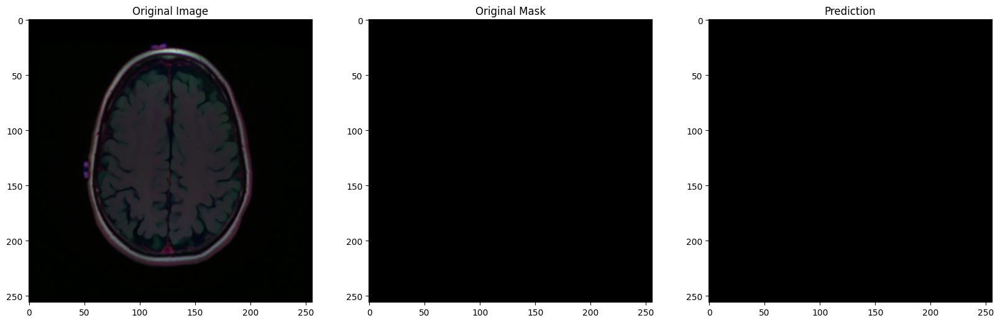

1/1 [==============================] - 0s 25ms/step


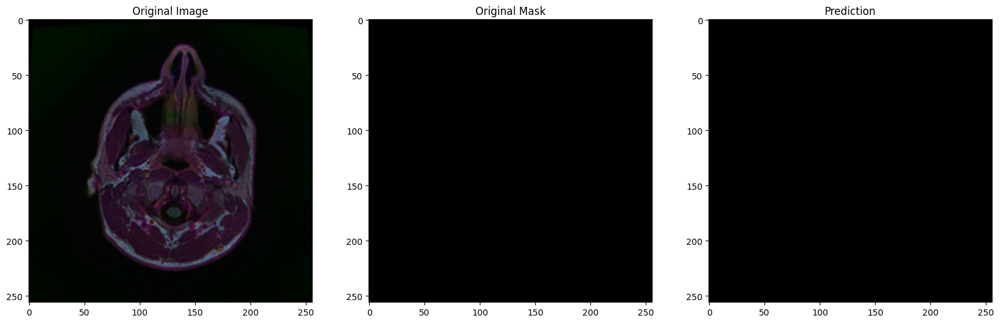

1/1 [==============================] - 0s 27ms/step


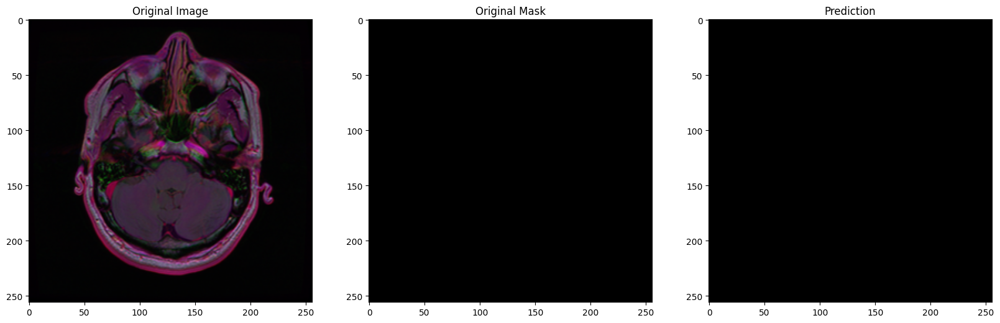

1/1 [==============================] - 0s 28ms/step


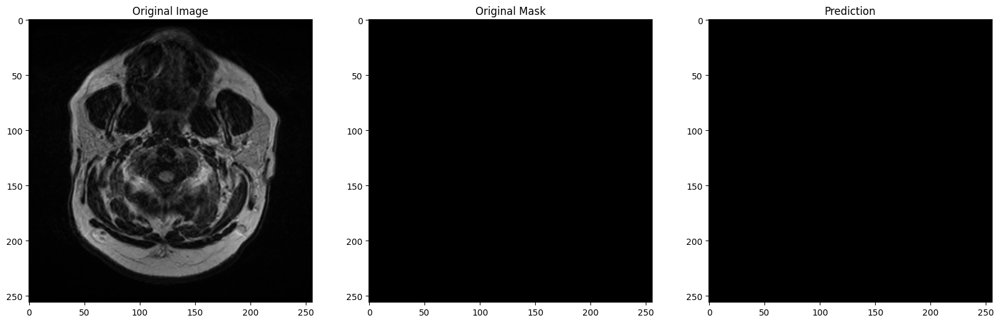

1/1 [==============================] - 0s 25ms/step


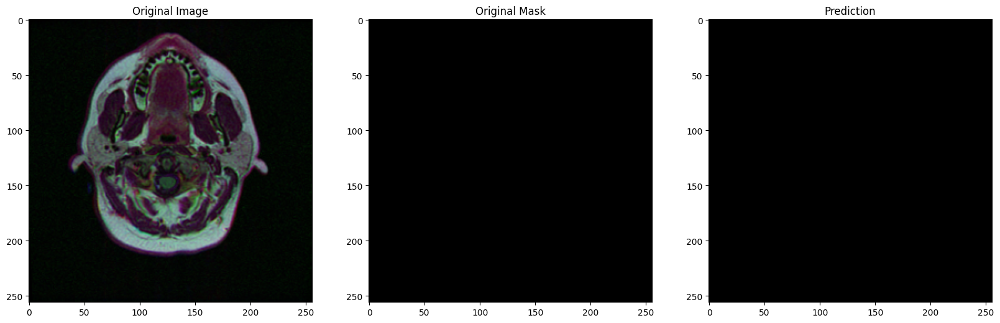

1/1 [==============================] - 0s 25ms/step


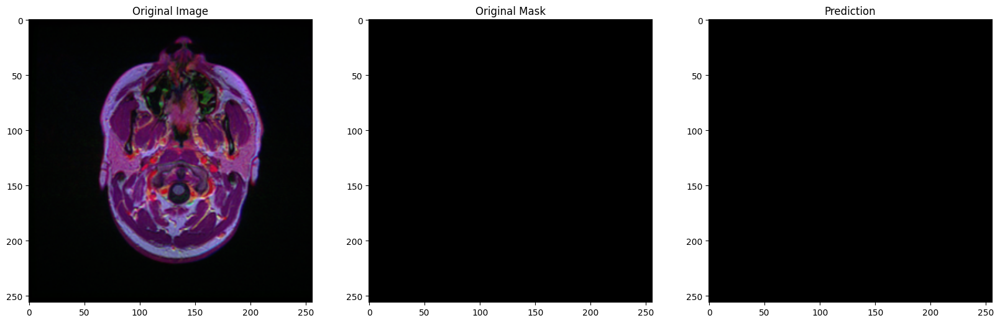

1/1 [==============================] - 0s 24ms/step


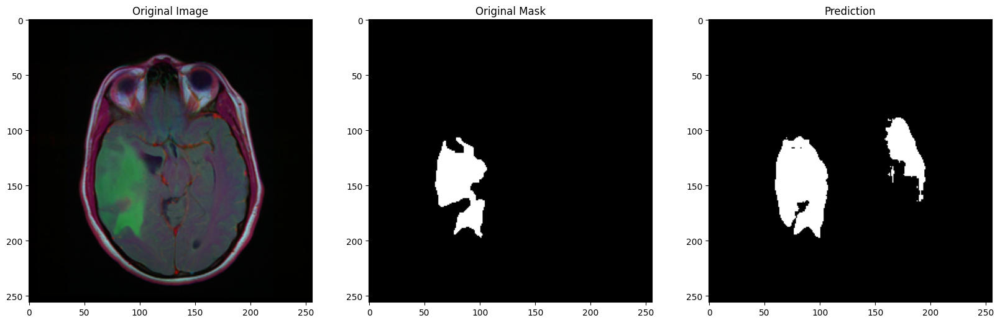

1/1 [==============================] - 0s 25ms/step


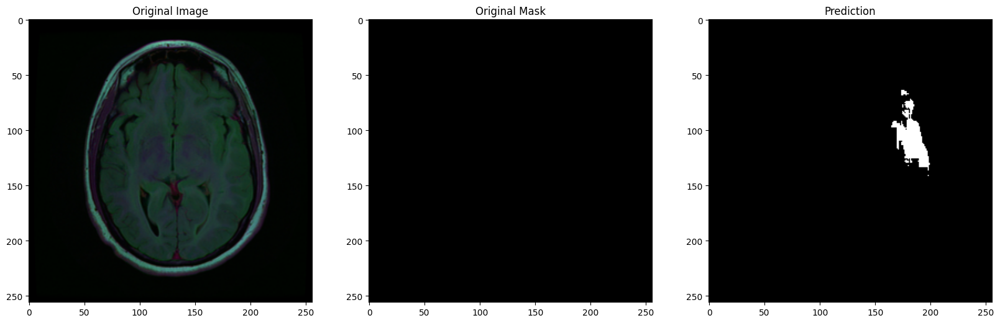

1/1 [==============================] - 0s 23ms/step


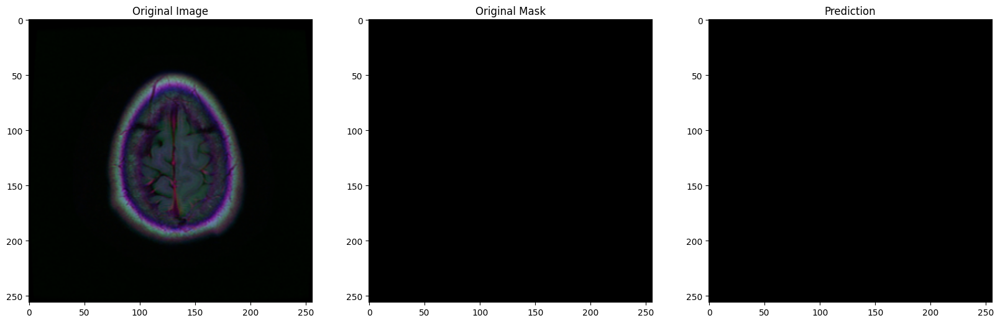

1/1 [==============================] - 0s 25ms/step


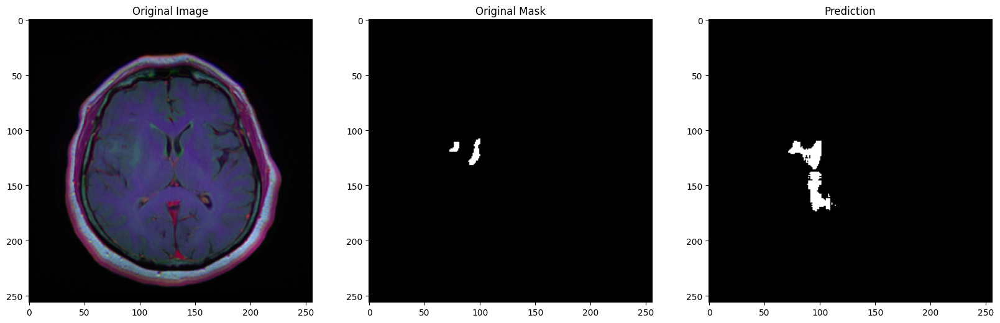

1/1 [==============================] - 0s 24ms/step


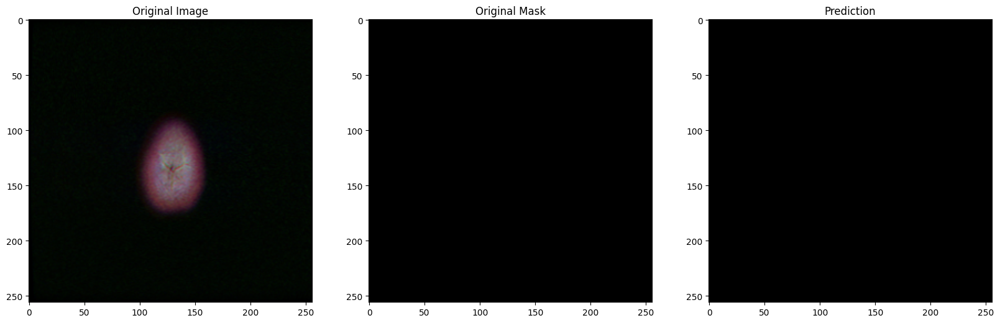

1/1 [==============================] - 0s 24ms/step


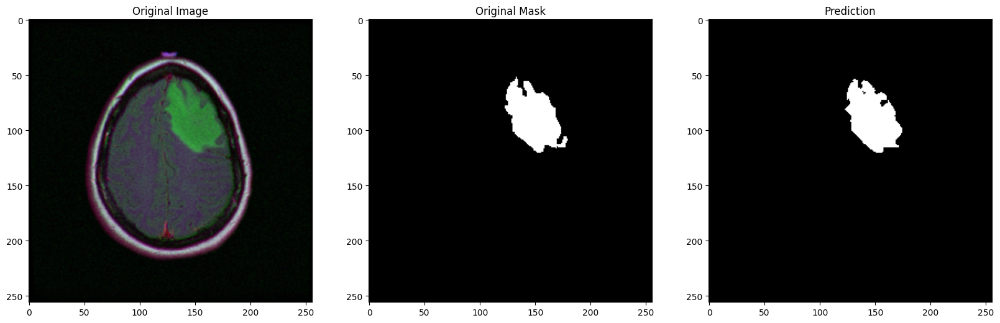

1/1 [==============================] - 0s 25ms/step


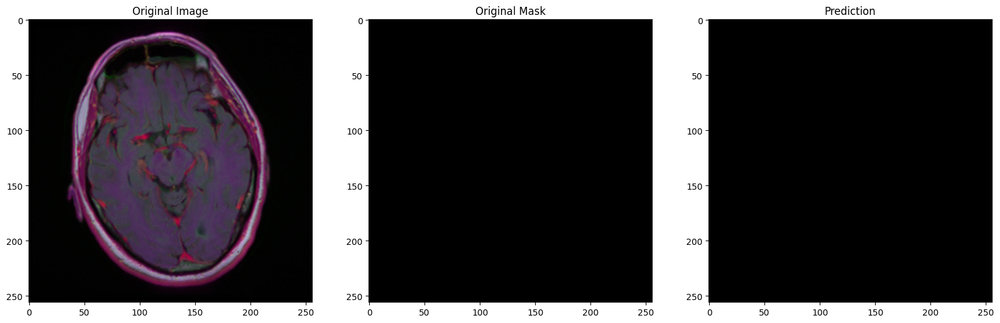

1/1 [==============================] - 0s 26ms/step


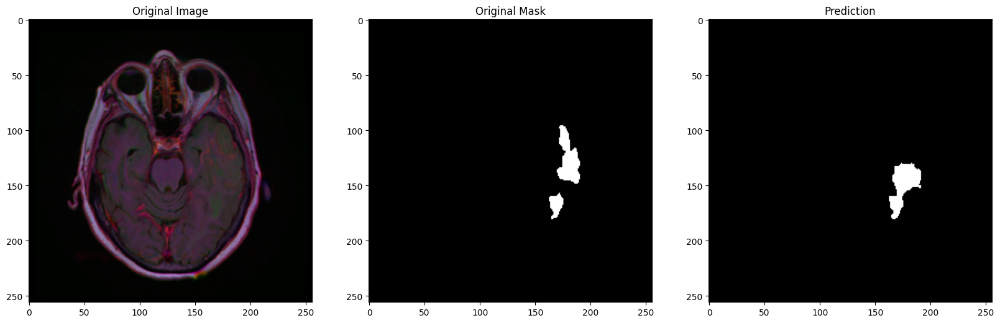

1/1 [==============================] - 0s 27ms/step


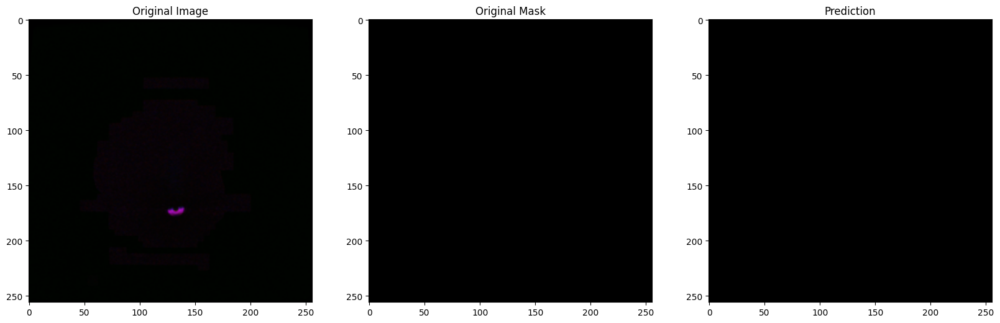

1/1 [==============================] - 0s 25ms/step


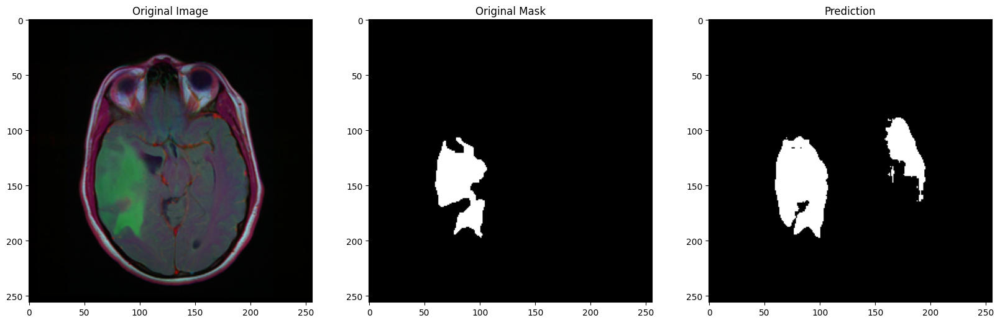

1/1 [==============================] - 0s 25ms/step


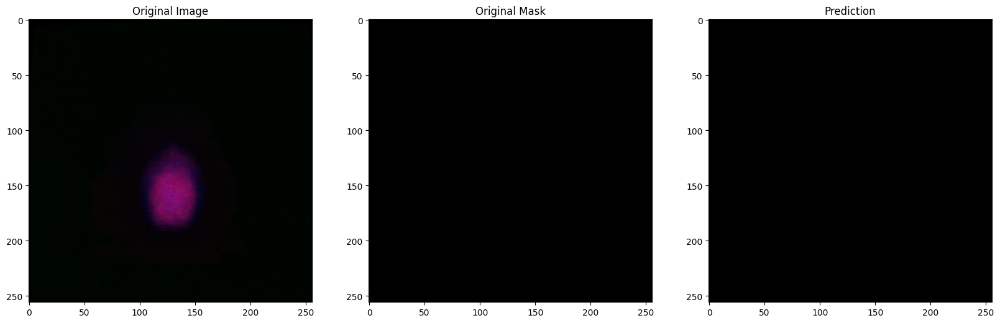

1/1 [==============================] - 0s 26ms/step


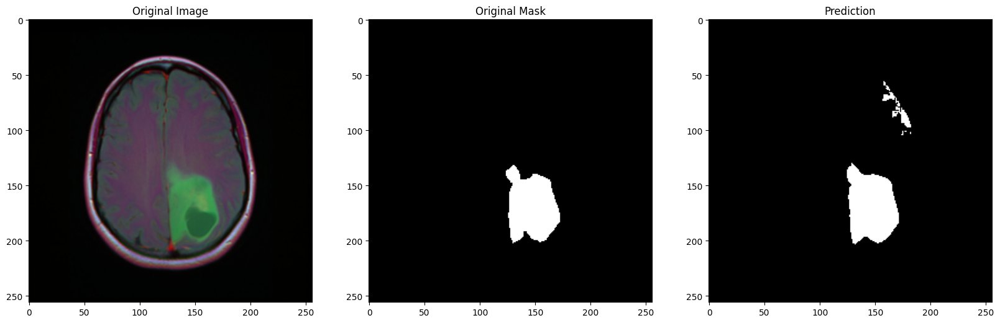

1/1 [==============================] - 0s 24ms/step


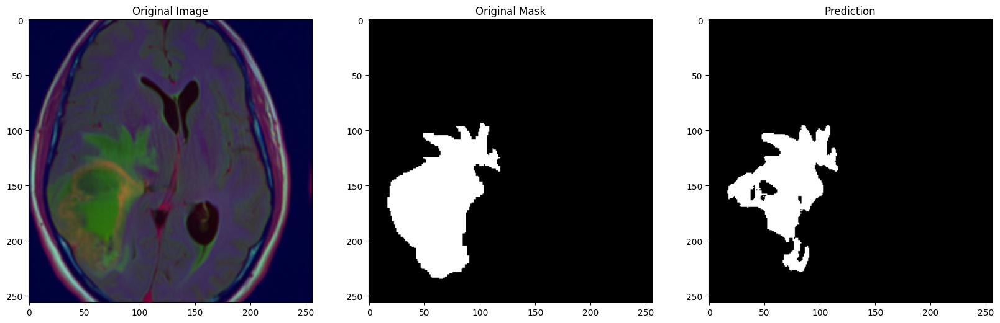

1/1 [==============================] - 0s 26ms/step


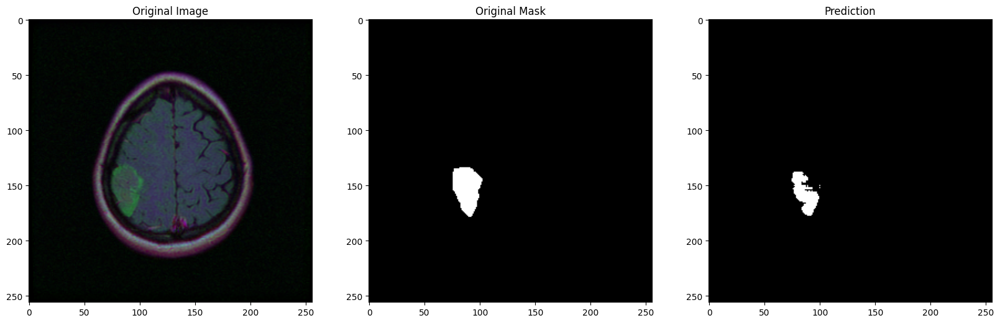

1/1 [==============================] - 0s 24ms/step


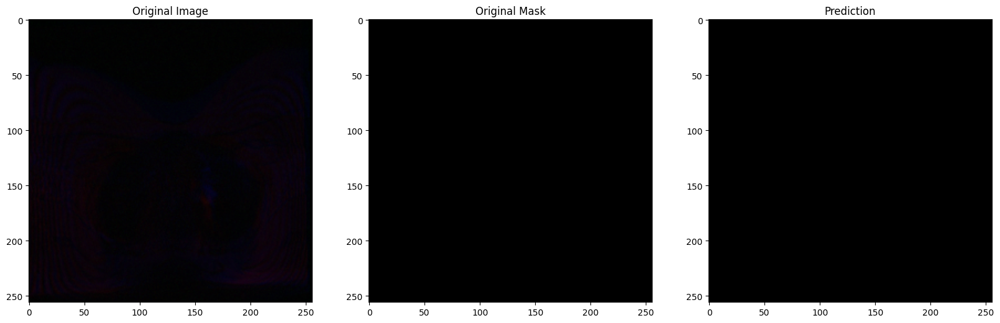

1/1 [==============================] - 0s 24ms/step


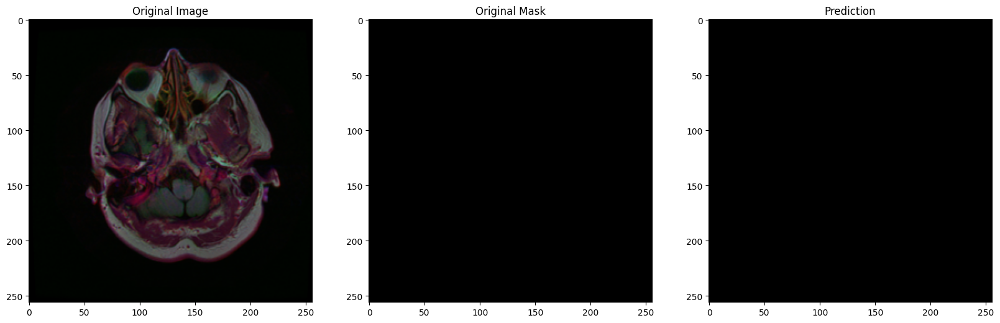

1/1 [==============================] - 0s 24ms/step


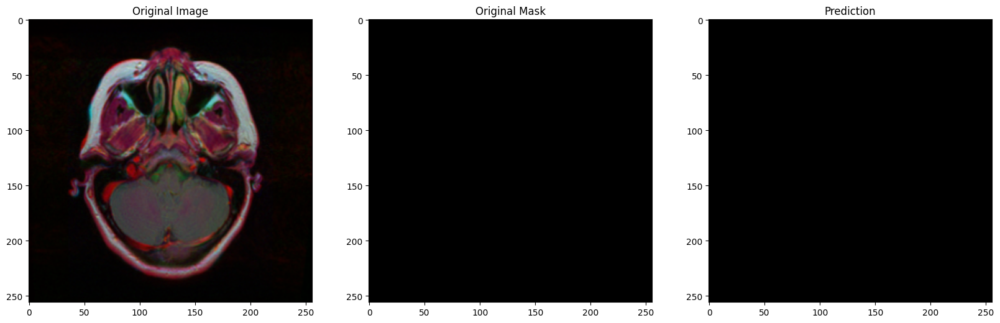

1/1 [==============================] - 0s 25ms/step


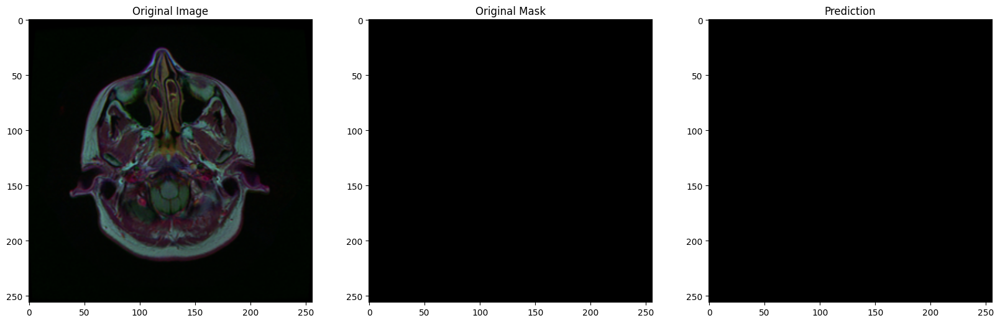

1/1 [==============================] - 0s 25ms/step


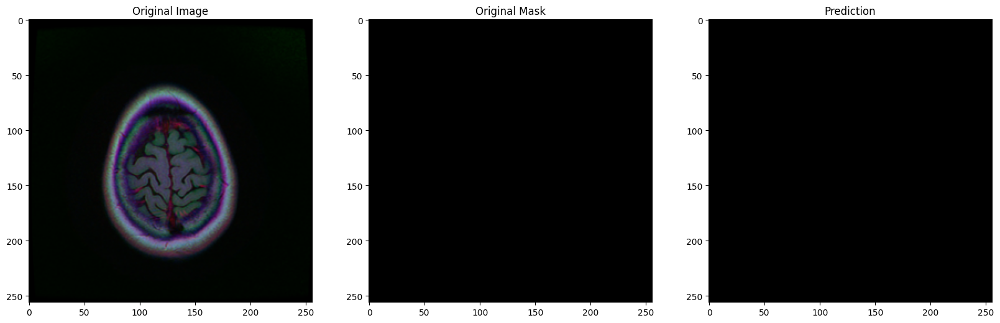

1/1 [==============================] - 0s 24ms/step


In [ ]:
for i in range(50):
    #------------------------------------------------------------------------------------------------------------------------------------------------------#
    index=np.random.randint(1,len(MRI_test.index))
    img = cv2.imread(MRI_test['images'].iloc[index])
    img = cv2.resize(img ,(256,256))
    img = img / 255
    img = img[np.newaxis, :, :, :]#Increasing the dimensions for predictions
    pred=model.predict(img)
    #------------------------------------------------------------------------------------------------------------------------------------------------------#
    plt.figure(figsize=(20,12))
    plt.subplot(1,3,1)
    plt.imshow(np.squeeze(img))
    plt.title('Original Image')
    plt.subplot(1,3,2)
    plt.imshow(np.squeeze(cv2.imread(MRI_test['masks'].iloc[index]))) #Reducing dimensions
    plt.title('Original Mask')
    plt.subplot(1,3,3)
    plt.imshow(np.squeeze(pred) > .5,cmap='gray')
    plt.title('Prediction')
    plt.show()